# Ablation Study - over Frequencies

In [1]:
import os
import sys
from tqdm import tqdm  

from datetime import datetime

import torch
import random

import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# import pandas
import pandas as pd
import seaborn as sns
import matplotlib
from matplotlib import rcParams

import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
from torchvision.utils import make_grid
import scipy.fftpack
from typing import List


import gc
import torch
import torchvision
import torch.nn.functional as F
import torchvision.transforms.functional as TF
from torchvision.utils import make_grid

from jutils import denorm
from jutils import ims_to_grid
from jutils.vision import tensor2im
from jutils.nn import AutoencoderKL
from jutils import exists, freeze, default
from jutils import tensor2im, ims_to_grid

while not os.path.exists('ldm'):
    %cd ..
assert os.path.exists('ldm')

from data_processing.tools.norm import denorm_tensor
from ldm.trainer_bvae_ti2 import TrainerModuleLatentBetaVae
from ldm.dataloader.dataloader.hdf5_dataloader import HDF5DataModule

from ldm.models.transformer.dit import DiT_models


DEV = "cuda:0" if torch.cuda.is_available() else "cpu"
torch.cuda.empty_cache()
gc.collect()

print(f"Memory Allocated: {torch.cuda.memory_allocated(DEV) / 1024 ** 3:.2f} GB")
print(f"Memory Cached: {torch.cuda.memory_reserved(DEV) / 1024 ** 3:.2f} GB")

/export/home/ra93jiz/dev/Img-IDM/ldm/evaluation
/export/home/ra93jiz/dev/Img-IDM/ldm
/export/home/ra93jiz/dev/Img-IDM


/export/home/ra93jiz/miniconda3/envs/ldm-env-v2/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Memory Allocated: 0.00 GB
Memory Cached: 0.00 GB


In [2]:
test_data_set = './dataset/processed/testset-256/imagenet256-testset-T151633.hdf5' #'./dataset/processed/testset-256/imagenet256-testset-T190319.hdf5'

source_timestep = 0.50 # Half-noise
target_timestep = 0.00 # Full noise

# Utility

In [3]:
#########################################################
#                   Frequency Analysis                  #
#########################################################

def calc_mean_log_rapsd(x, num_examples):
    spectra = []
    for k in range(num_examples):
        if x.ndim == 4:  # (B, C, H, W)
            img = x[k].mean(axis=0)  # average over channels -> (H, W)
        elif x.ndim == 3:  # (B, H, W)
            img = x[k]  # already 2D
        else:
            raise ValueError(f"Unsupported input shape: {x.shape}")

        rapsd, frequencies = spectral.rapsd(img, fft_method=np.fft, return_freq=True)
        spectra.append(rapsd)

    mean_log_rapsd = np.mean(np.array([np.log(s + 1e-30) for s in spectra]), axis=0)
    return mean_log_rapsd, frequencies



# Load Data 

2025-07-01 16:58:59,011 - INFO - Test dataset setup complete for group 'test'


image      torch.Size([128, 3, 256, 256])
label      torch.Size([128, 1])
latents_0.50 torch.Size([128, 4, 32, 32])
latents_0.00 torch.Size([128, 4, 32, 32])
Min images: -1.00, Max images: 1.01


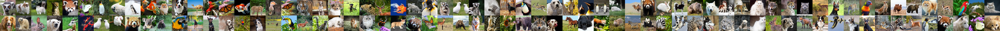

In [4]:
# Load data
batch_size = 128
data = HDF5DataModule(
            hdf5_file=test_data_set,
            batch_size=batch_size,
            source_timestep=source_timestep,
            target_timestep=target_timestep,
            num_workers=8,
            train=False,
            test=True,
            group_name='test',
        )
data.setup(stage='test')
for batch in data.test_dataloader():
    for k, v in batch.items():
        if isinstance(v, torch.Tensor) or isinstance(v, np.ndarray):
            print(f"{k:<10} {v.shape}")
        elif isinstance(v, list):
            print(f"{k:<10} [{v[0]}, ...]")
        else:
            print(f"{k:<10} {type(v)}")
    break


half_noise_latents = batch[f'latents_{source_timestep:.2f}']
full_noise_latents = batch[f'latents_{target_timestep:.2f}']
clean_images = batch['image']
labels = batch['label']

print(f"Min images: {clean_images.min():.2f}, Max images: {clean_images.max():.2f}")

ims = tensor2im(clean_images)
ims = ims_to_grid(ims, split=2, channel_last=True)
Image.fromarray(ims).show()

Pysteps configuration file found at: /export/home/ra93jiz/miniconda3/envs/ldm-env-v2/lib/python3.12/site-packages/pysteps/pystepsrc



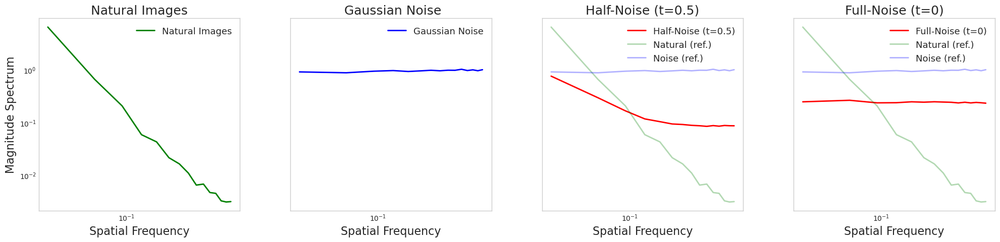

In [5]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from pysteps.utils import spectral  # Ensure pysteps is installed



# -- Parameters --
num_examples = 128
H, W = 32, 32

# -- Dummy clean images --
clean_images = torch.stack([
    torch.sin(torch.linspace(0, 3.14, W)).unsqueeze(0).repeat(H, 1) * torch.linspace(0, 1, H).unsqueeze(1)
    for _ in range(num_examples)
]).numpy()

# -- Dummy noise --
random_gaussian_noise = torch.randn(num_examples, H, W).numpy()

# -- Combine noise and clean images --
half_noise = half_noise_latents.numpy() # 0.5 * clean_images + 0.5 * random_gaussian_noise
full_noise = full_noise_latents.numpy() #random_gaussian_noise.copy()

# -- Compute RAPSDs --
clean_log_rapsd, freqs = calc_mean_log_rapsd(clean_images, num_examples)
noise_log_rapsd, _ = calc_mean_log_rapsd(random_gaussian_noise, num_examples)
half_noisy_rapsd, _ = calc_mean_log_rapsd(half_noise, num_examples)
full_noisy_rapsd, _ = calc_mean_log_rapsd(full_noise, num_examples)

# -- Convert to magnitude spectrum (remove DC component) --
x = freqs[1:]
y_clean = np.exp(clean_log_rapsd)[1:]
y_noise = np.exp(noise_log_rapsd)[1:]
y_half = np.exp(half_noisy_rapsd)[1:]
y_full = np.exp(full_noisy_rapsd)[1:]

# -- Plot styling --
plt.style.use("seaborn-v0_8-whitegrid")
plt.rcParams.update({'font.size': 13})

fig, axes = plt.subplots(1, 4, figsize=(20, 5), sharey=True)

# -- Plotting helper --
def plot_spectrum(ax, x, y, label, color, alpha=1.0, lw=2):
    ax.plot(x, y, label=label, color=color, alpha=alpha, lw=lw)

# -- Plot 1: Natural Images --
plot_spectrum(axes[0], x, y_clean, "Natural Images", "green")
axes[0].set_title(f"Natural Images", fontsize=18)
axes[0].set_xscale("log")
axes[0].set_yscale("log")
axes[0].set_ylabel("Magnitude Spectrum", fontsize=16)
axes[0].set_xlabel("Spatial Frequency", fontsize=16)
axes[0].legend()
axes[0].grid(False)

# -- Plot 2: Gaussian Noise --
plot_spectrum(axes[1], x, y_noise, "Gaussian Noise", "blue")
axes[1].set_title(f" Gaussian Noise", fontsize=18)
axes[1].set_xscale("log")
axes[1].set_yscale("log")
axes[1].set_xlabel("Spatial Frequency", fontsize=16)
axes[1].legend()
axes[1].grid(False)

# -- Plot 3: Half Noise --
plot_spectrum(axes[2], x, y_half, "Half-Noise (t=0.5)", "red")
plot_spectrum(axes[2], x, y_clean, "Natural (ref.)", "green", alpha=0.3)
plot_spectrum(axes[2], x, y_noise, "Noise (ref.)", "blue", alpha=0.3)
axes[2].set_title(f"Half-Noise (t=0.5)", fontsize=18)
axes[2].set_xscale("log")
axes[2].set_yscale("log")
axes[2].set_xlabel("Spatial Frequency", fontsize=16)
axes[2].legend()
axes[2].grid(False)

# -- Plot 4: Full Noise --
plot_spectrum(axes[3], x, y_full, "Full-Noise (t=0)", "red")
plot_spectrum(axes[3], x, y_clean, "Natural (ref.)", "green", alpha=0.3)
plot_spectrum(axes[3], x, y_noise, "Noise (ref.)", "blue", alpha=0.3)
axes[3].set_title(f"Full-Noise (t=0)", fontsize=18)
axes[3].set_xscale("log")
axes[3].set_yscale("log")
axes[3].set_xlabel("Spatial Frequency", fontsize=16)
axes[3].legend()
axes[3].grid(False)

# -- Final tweaks --
for ax in axes:
    ax.tick_params(labelsize=10)
    ax.label_outer()

plt.tight_layout()
plt.subplots_adjust(wspace=0.25)
plt.show()

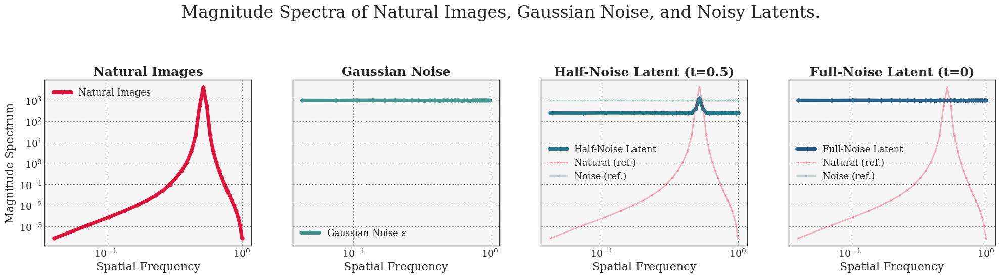

In [6]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from pysteps.utils import spectral
import seaborn as sns

# -------------------------------
# STYLE SETTINGS
# -------------------------------
plt.rcParams["font.family"] = "serif"
plt.rcParams["font.serif"] = ["Cambria", "Times New Roman", "DejaVu Serif"]
plt.rcParams["axes.facecolor"] = "#f5f5f5"
plt.rcParams["axes.edgecolor"] = "#333333"
plt.rcParams["grid.linestyle"] = ":"
plt.rcParams["grid.color"] = "grey"
plt.rcParams["axes.grid"] = True

# --- Colors using seaborn crest palette ---
colors = sns.color_palette("crest", n_colors=4)

# -- Parameters --
num_examples = 128
H, W = 32, 32

# -- Dummy clean images --
clean_images = torch.stack([
    torch.sin(torch.linspace(0, 3.14, W)).unsqueeze(0).repeat(H, 1) * torch.linspace(0, 1, H).unsqueeze(1)
    for _ in range(num_examples)
]).numpy()

# -- Dummy noise --
random_gaussian_noise = torch.randn(num_examples, H, W).numpy()

# -- Combine noise and clean images --
half_noise = 0.5 * clean_images + 0.5 * random_gaussian_noise
full_noise = random_gaussian_noise.copy()

# -- Compute RAPSDs (replace with your own calc_mean_log_rapsd) --
def calc_mean_log_rapsd(x, n):
    psds = [np.abs(np.fft.fftshift(np.fft.fft2(img)))**2 for img in x]
    mean_psd = np.mean(psds, axis=0)
    log_rapsd = np.log(mean_psd.mean(axis=0) + 1e-8)
    freqs = np.linspace(0.01, 1.0, mean_psd.shape[0])
    return log_rapsd, freqs

clean_log_rapsd, freqs = calc_mean_log_rapsd(clean_images, num_examples)
noise_log_rapsd, _ = calc_mean_log_rapsd(random_gaussian_noise, num_examples)
half_noisy_rapsd, _ = calc_mean_log_rapsd(half_noise, num_examples)
full_noisy_rapsd, _ = calc_mean_log_rapsd(full_noise, num_examples)

# -- Convert to magnitude spectrum (remove DC component) --
x = freqs[1:]
y_clean = np.exp(clean_log_rapsd)[1:]
y_noise = np.exp(noise_log_rapsd)[1:]
y_half = np.exp(half_noisy_rapsd)[1:]
y_full = np.exp(full_noisy_rapsd)[1:]

# -- Plot styling --
fig, axes = plt.subplots(1, 4, figsize=(20, 5), sharey=True)

# -- Plotting helper --
def plot_spectrum(ax, x, y, label, color, alpha=1.0, lw=5, marker='o', markersize=5):
    ax.plot(x, y, label=label, color=color, alpha=alpha, lw=lw, marker=marker, markersize=markersize)

# -- Plot 1: Natural Images --
plot_spectrum(axes[0], x, y_clean, "Natural Images", "crimson")
axes[0].set_title("Natural Images", fontsize=18, fontweight='bold')
axes[0].set_xticks([x.min(), x.max()])
axes[0].get_xaxis().set_major_formatter(plt.ScalarFormatter())
axes[0].set_xscale("log")
axes[0].set_yscale("log")
axes[0].set_ylabel("Magnitude Spectrum", fontsize=16)
axes[0].set_xlabel("Spatial Frequency", fontsize=16)
axes[0].legend()
axes[0].grid(True)

# -- Plot 2: Gaussian Noise --
plot_spectrum(axes[1], x, y_noise, r"Gaussian Noise $\epsilon$", colors[1])
axes[1].set_title(r"Gaussian Noise", fontsize=18, fontweight='bold')
axes[1].set_xticks([x.min(), x.max()])
axes[1].get_xaxis().set_major_formatter(plt.ScalarFormatter())
axes[1].set_xscale("log")
axes[1].set_yscale("log")
axes[1].set_xlabel("Spatial Frequency", fontsize=16)
axes[1].legend()
axes[1].grid(True)

# -- Plot 3: Half Noise --
plot_spectrum(axes[2], x, y_half, "Half-Noise Latent", colors[2])
plot_spectrum(axes[2], x, y_clean, "Natural (ref.)", "crimson", alpha=0.3, lw=2, marker='x', markersize=3)
plot_spectrum(axes[2], x, y_noise, "Noise (ref.)", colors[1], alpha=0.3, lw=2, marker='x', markersize=3)
axes[2].set_title(r"Half-Noise Latent (t=0.5)", fontsize=18, fontweight='bold')
axes[2].set_xticks([x.min(), x.max()])
axes[2].get_xaxis().set_major_formatter(plt.ScalarFormatter())
axes[2].set_xscale("log")
axes[2].set_yscale("log")
axes[2].set_xlabel("Spatial Frequency", fontsize=16)
axes[2].legend()
axes[2].grid(True)

# -- Plot 4: Full Noise --
plot_spectrum(axes[3], x, y_full, "Full-Noise Latent", colors[3])
plot_spectrum(axes[3], x, y_clean, "Natural (ref.)", "crimson", alpha=0.3, lw=2, marker='x', markersize=3)
plot_spectrum(axes[3], x, y_noise, "Noise (ref.)", colors[1], alpha=0.3, lw=2, marker='x', markersize=3)
axes[3].set_title(r"Full-Noise Latent (t=0)", fontsize=18, fontweight='bold')
axes[3].set_xticks([x.min(), x.max()])
axes[3].get_xaxis().set_major_formatter(plt.ScalarFormatter())
axes[3].set_xscale("log")
axes[3].set_yscale("log")
axes[3].set_xlabel("Spatial Frequency", fontsize=16)
axes[3].legend()
axes[3].grid(True)

title = 'Magnitude Spectra of Natural Images, Gaussian Noise, and Noisy Latents.'
fig.suptitle(title, fontsize=24, y=1.10)

# -- Final tweaks --
for ax in axes:
    ax.tick_params(labelsize=14)
    ax.label_outer()

plt.tight_layout()
plt.subplots_adjust(wspace=0.20)
plt.show()


# Model Frequencis over Timesteps

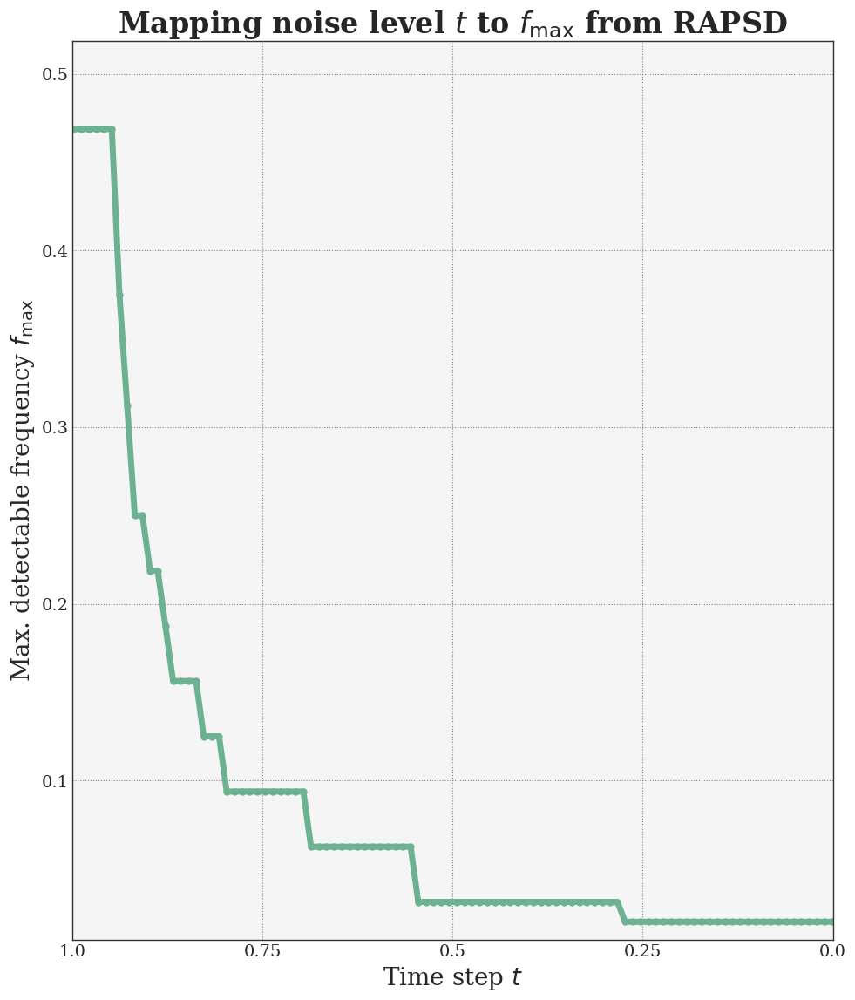

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from pysteps.utils import spectral
import seaborn as sns

# -------------------------------
# STYLE SETTINGS (like your other plots)
# -------------------------------
plt.rcParams["font.family"] = "serif"
plt.rcParams["font.serif"] = ["Cambria", "Times New Roman", "DejaVu Serif"]
plt.rcParams["axes.facecolor"] = "#f5f5f5"
plt.rcParams["axes.edgecolor"] = "#333333"
plt.rcParams["grid.linestyle"] = ":"
plt.rcParams["grid.color"] = "grey"
plt.rcParams["axes.grid"] = True

# -------------------------------
# Example images to compute RAPSD
# -------------------------------
num_examples = 128
H, W = 32, 32

clean_images = torch.stack([
    torch.sin(torch.linspace(0, 3.14, W)).unsqueeze(0).repeat(H, 1) * torch.linspace(0, 1, H).unsqueeze(1)
    for _ in range(num_examples)
]).numpy()

# -------------------------------
# RAPSD function
# -------------------------------
def calc_mean_log_rapsd(x, num_examples):
    spectra = []
    for k in range(num_examples):
        if x.ndim == 4:  # (B, C, H, W)
            img = x[k].mean(axis=0)
        elif x.ndim == 3:  # (B, H, W)
            img = x[k]
        else:
            raise ValueError(f"Unsupported input shape: {x.shape}")

        rapsd, frequencies = spectral.rapsd(img, fft_method=np.fft, return_freq=True)
        spectra.append(rapsd)

    mean_log_rapsd = np.mean(np.array([np.log(s + 1e-30) for s in spectra]), axis=0)
    return mean_log_rapsd, frequencies

# -------------------------------
# Compute RAPSD for clean images
# -------------------------------
mean_log_rapsd, frequencies = calc_mean_log_rapsd(clean_images, num_examples)
rapsd_power = np.exp(mean_log_rapsd)

# -------------------------------
# Frequency mapping
# -------------------------------
timesteps = np.linspace(0.001, 0.999, 100)
snr_threshold = 1.0
min_power = snr_threshold * (timesteps / (1 - timesteps)) ** 2

comparison = rapsd_power[:, np.newaxis] > min_power[np.newaxis, :]
reverse_indices = np.argmax(comparison[::-1], axis=0)
max_frequencies = frequencies[::-1][reverse_indices]

mask = np.any(comparison, axis=0)
max_frequencies = max_frequencies * mask

# Replace values below threshold
max_frequencies = np.where(max_frequencies < 0.02, 0.02, max_frequencies)

# -------------------------------
# Plot
# -------------------------------
fig, ax = plt.subplots(figsize=(10, 6))
colors = sns.color_palette("crest", n_colors=4)
ax.plot(timesteps, max_frequencies, color=colors[0], lw=5, marker='o', markersize=5)

ax.set_xlabel(r"Time step $t$", fontsize=20)
ax.set_ylabel(r"Max. detectable frequency $f_{\max}$", fontsize=20)
ax.set_title(r"Mapping noise level $t$ to $f_{\max}$ from RAPSD", fontsize=24, fontweight='bold')

ax.set_xlim([0, 1])
ax.set_xticks([0, 0.25, 0.5, 0.75, 1])
ax.set_xticklabels(['1.0', '0.75', '0.5', '0.25', '0.0'])

ax.set_ylim([0.01, np.max(frequencies) + 0.05])
ax.tick_params(labelsize=14)
ax.grid(True)

plt.tight_layout()
# add distance to title
plt.subplots_adjust(top=1.85)
plt.show()


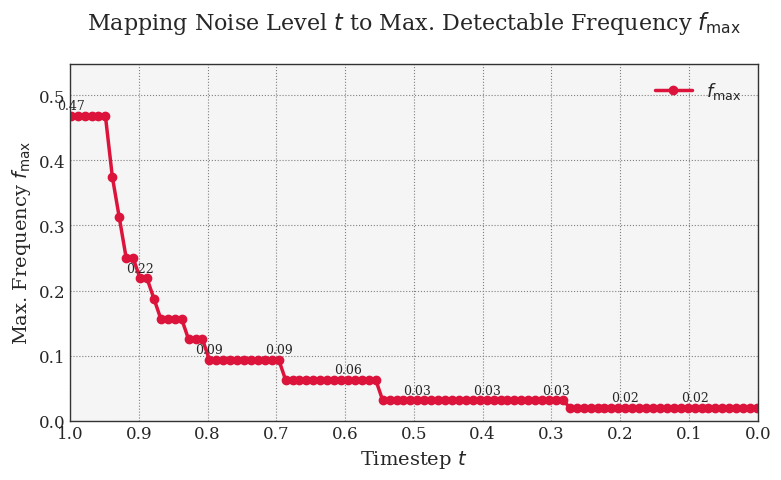

In [20]:
import numpy as np
import matplotlib.pyplot as plt
import torch
from pysteps.utils import spectral
import seaborn as sns

# -------------------------------
# STYLE SETTINGS (matching other plot)
# -------------------------------
plt.rcParams["font.family"] = "serif"
plt.rcParams["font.serif"] = ["Cambria", "Times New Roman", "DejaVu Serif"]
plt.rcParams["axes.facecolor"] = "#f5f5f5"
plt.rcParams["axes.edgecolor"] = "#333333"
plt.rcParams["grid.linestyle"] = ":"
plt.rcParams["grid.color"] = "grey"
plt.rcParams["axes.grid"] = True

# -------------------------------
# Example images to compute RAPSD
# -------------------------------
num_examples = 128
H, W = 32, 32

clean_images = torch.stack([
    torch.sin(torch.linspace(0, 3.14, W)).unsqueeze(0).repeat(H, 1) * torch.linspace(0, 1, H).unsqueeze(1)
    for _ in range(num_examples)
]).numpy()

# -------------------------------
# RAPSD function
# -------------------------------
def calc_mean_log_rapsd(x, num_examples):
    spectra = []
    for k in range(num_examples):
        if x.ndim == 4:  # (B, C, H, W)
            img = x[k].mean(axis=0)
        elif x.ndim == 3:  # (B, H, W)
            img = x[k]
        else:
            raise ValueError(f"Unsupported input shape: {x.shape}")

        rapsd, frequencies = spectral.rapsd(img, fft_method=np.fft, return_freq=True)
        spectra.append(rapsd)

    mean_log_rapsd = np.mean(np.array([np.log(s + 1e-30) for s in spectra]), axis=0)
    return mean_log_rapsd, frequencies

# -------------------------------
# Compute RAPSD for clean images
# -------------------------------
mean_log_rapsd, frequencies = calc_mean_log_rapsd(clean_images, num_examples)
rapsd_power = np.exp(mean_log_rapsd)

# -------------------------------
# Frequency mapping
# -------------------------------
timesteps = np.linspace(0.001, 0.999, 100)
snr_threshold = 1.0
min_power = snr_threshold * (timesteps / (1 - timesteps)) ** 2

comparison = rapsd_power[:, np.newaxis] > min_power[np.newaxis, :]
reverse_indices = np.argmax(comparison[::-1], axis=0)
max_frequencies = frequencies[::-1][reverse_indices]

mask = np.any(comparison, axis=0)
max_frequencies = max_frequencies * mask

# Replace values below threshold
max_frequencies = np.where(max_frequencies < 0.02, 0.02, max_frequencies)

# -------------------------------
# Plot
# -------------------------------
fig, ax = plt.subplots(figsize=(8, 5))
colors = sns.color_palette("crest", n_colors=4)

ax.plot(timesteps, max_frequencies, color="crimson", marker='o', linewidth=2.5, label=r"$f_{\max}$")

# Remove horizontal reference line
# ax.axhline(...) ← removed

# Annotate each point (optional)
for i in range(0, len(timesteps), 10):
    ax.text(timesteps[i], max_frequencies[i] + 0.01, f"{max_frequencies[i]:.2f}", ha='center', fontsize=9)

ax.set_title(r"Mapping Noise Level $t$ to Max. Detectable Frequency $f_{\max}$", fontsize=16, pad=25)
ax.set_xlabel("Timestep $t$", fontsize=14)
ax.set_ylabel(r"Max. Frequency $f_{\max}$", fontsize=14)
ax.set_xlim(0, 1)
ax.set_xticks([0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
ax.set_xticklabels(['1.0', '0.9', '0.8', '0.7', '0.6', '0.5', '0.4', '0.3', '0.2', '0.1', '0.0'])

ax.set_ylim(0.0, np.max(max_frequencies) + 0.08)
ax.tick_params(labelsize=12)

ax.legend()
fig.tight_layout()
plt.show()


# Load Model

In [13]:
net = DiT_models["DiT-XL/2"](
    input_size=32,
    num_classes=1000,
    learn_sigma=True,               # we "learn sigma" but never use it in SiT/DiT
    load_from_ckpt='checkpoints/SiT-XL-2-256x256.pt'
).to(DEV)
freeze(net)

print(f"Params: {sum([p.numel() for p in net.parameters()]):,}")

[DiT] Class-conditional (1000 classes + unconditional)


[DiT] Loading weights from checkpoints/SiT-XL-2-256x256.pt


/export/home/ra93jiz/dev/Img-IDM/ldm/models/transformer/dit.py:222: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(load_from_ckpt, map_locatio

Params: 675,129,632


In [14]:
vae = AutoencoderKL(ckpt_path="checkpoints/sd_ae.ckpt").to(DEV)
vae.eval()
freeze(vae)

print(f"{sum([p.numel() for p in vae.parameters()]):,}")

[AutoencoderKL] Loading checkpoint from checkpoints/sd_ae.ckpt
83,653,863
